# Traffic Volume Counts Data Generator

Let's use the open source [Python SDK](https://github.com/mostly-ai/mostlyai) from [MOSTLY AI](https://mostly.ai/) to generate a synthetic dataset using [Traffic Volume Counts](https://catalog.data.gov/dataset/traffic-volume-counts) from `data.gov`.

## What is synthetic data? 

We'll use the the original traffic dataset to generate synthetic rows that preserve statistical relationships (e.g., if morning traffic is usually higher on the FDR northbound, synthetic data reflects that). 

Synthetic data is artificially generated data that mimics the patterns and structure of real data but does not contain any actual records from the original source. In our case, it is used for training machine learning and preserving privacy when real data is sensitive, incomplete, or unavailable.

## Why use synthetic data? 

There are a number of reasons to use synthetic data. Not only does it help to preserve privacy when creating open source models and datasets, but actual traffic count data is not be available for all intersections or time periods. We want to have a dataset that is as representative as possible for the entire domain.

Furthermore, we want to simulate how traffic patterns might look under unusual or hypothetical conditions—like during a marathon, blackout, or natural disaster. Generating synthetic data based on a defined subset of the whole is a perfect way to amplify certain trends.

Last, but certainly not least, is simply a matter of volume. Training an AI model is more effective the more data you have. Our base dataset is only about 50,000 rows, and once we identify a specific subset of data, it will be significantly less than that. An effective AI/ML model needs a healthy amount of data to be effectively post-trained.

# Configuring the generator

The MOSTLY AI Python SDK supports a ton of parameters to customize your synthetic data generator. The generator for these purposes is pretty simple, but the entire list of parameters can be found in the [MOSTLY AI documentation](https://mostly-ai.github.io/mostlyai/syntax/).

## Parameters

We'll focus on two parameters for this exercise:

- `max_training_time`: sets a time limit for the training process of the synthetic data generation model. Once this time limit is reached, the training stops, even if the model has not fully converged or reached its optimal state. Remember, convergence refers to the point at which the model's training process stabilizes, meaning that further training does not significantly improve the model's performance or the quality of the synthetic data being generated. Controlling for max training time allows you to make your training pipeline significantly more performative, at the expense of generating less optimal data.
- `differential_privacy`: a mathematical framework used to ensure privacy when generating synthetic data. Differential privacy provides strong guarantees that the synthetic data does not reveal sensitive information about individuals in the original dataset. When generating synthetic data, differential privacy ensures that the synthetic data cannot be used to infer sensitive information about individuals in the original dataset. `max_epsilon` is the maximum allowable value for epsilon during the synthetic data generation process. `delta` is the probability that the privacy guarantee (epsilon) could be violated (so a smaller value means a lower chance). When generating synthetic data with potentially sensitive information, it's up to the data engineer to decide the best differential privacy values for their specific use case.

In [1]:
# Building the data generation pipeline with MOSTLY AI

import pandas as pd
from mostlyai.sdk import MostlyAI

# load original data.gov data from local repository
df_original = pd.read_csv('./data/traffic-volume-counts.csv')

# instantiate SDK
mostly = MostlyAI(local=True)

# train a generator
gen = mostly.train(config={
        'name': 'Traffic Volume Counts',          # name of the generator
        'tables': [{                              # provide list of table(s)
            'name': 'train',                      # name of the generated table
            'data': df_original,                  # the original data as pd.DataFrame
            'tabular_model_configuration': {      # tabular model configuration (optional)
                'max_training_time': 3,           # cap runtime for demo; set None for max accuracy
                'differential_privacy': {         # differential privacy configuration (optional)
                    'max_epsilon': 7.0,           # - max epsilon value, used as stopping criterion
                    'delta': 1e-5,                # - delta value
                }
            },
        }]
    },
)

Initializing Synthetic Data SDK 4.4.2 in LOCAL mode 🏠

Connected to ]8;id=322111;file:///Users/kenneth.hamilton/mostlyai\/Users/kenneth.hamilton/]8;;\]8;id=788093;file:///Users/kenneth.hamilton/mostlyai\mostlyai]8;;\ with 16 GB RAM, 10 CPUs, 0 GPUs available

Created generator 929610b2-7af5-4cd1-9aa5-5d30f7b657fd

Started generator training

Output()

🎉 Your generator is ready! Use it to create synthetic data. Publish it so others can do the same.

# Generate a Report

MOSTLY AI has a really cool feature whereby it can generate a complete report for you based on the training of your generator model. This lets you work with the configuration that you've deployed to ensure that the results meet the needs of your use case. In this example, I've used the configuration above, but maybe you'd like to tweak a few parameters and create a completely different generator? Give it a try.


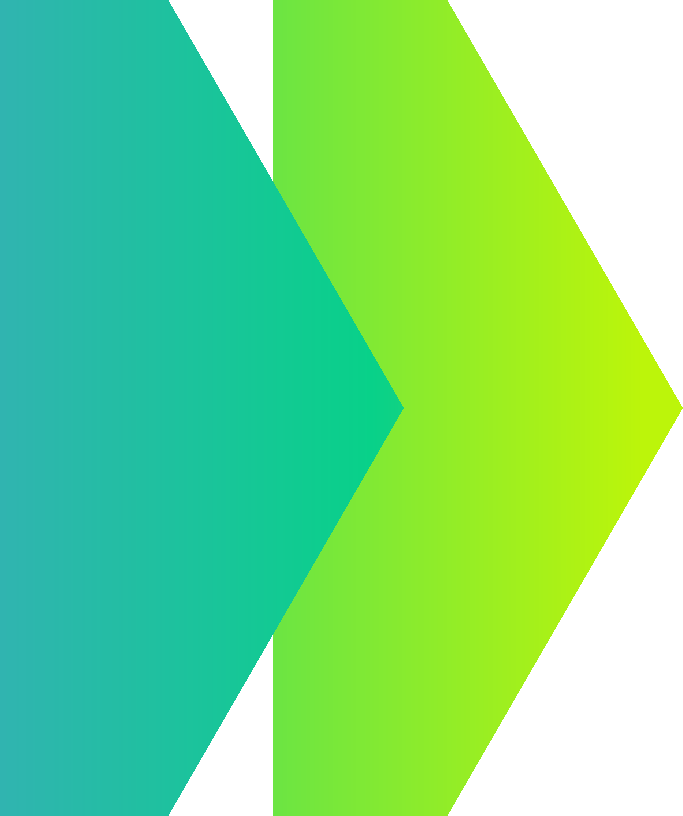
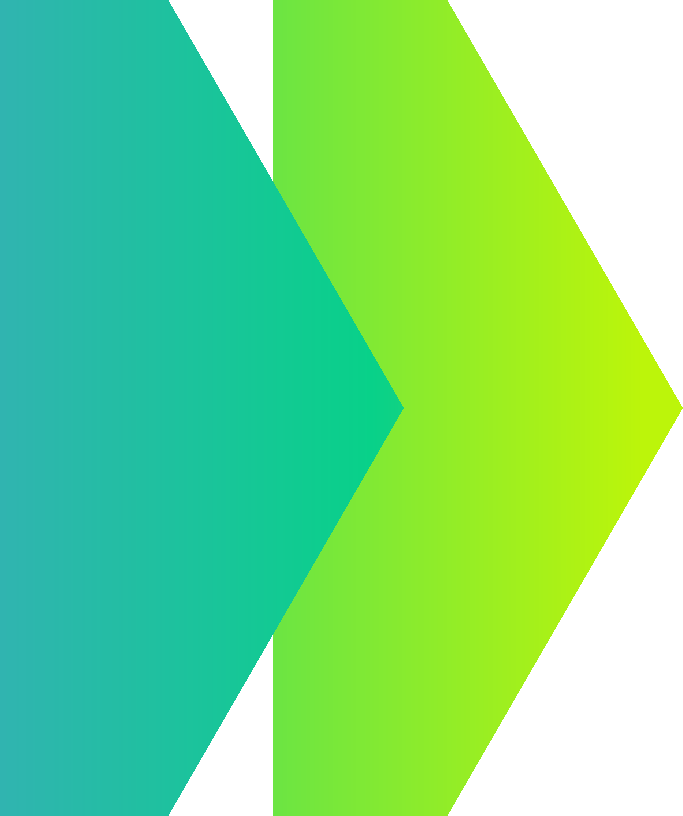
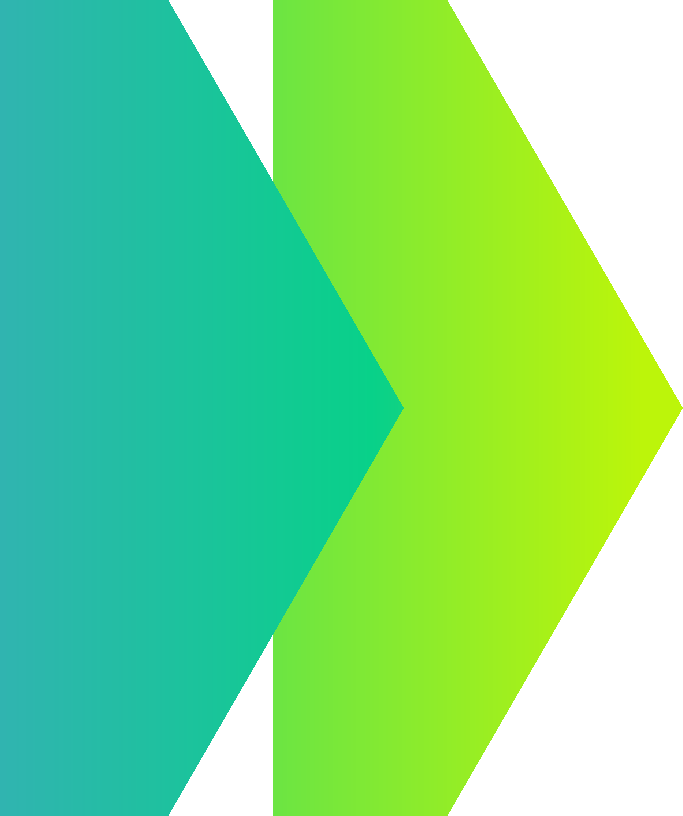

In [ ]:
# Generate a report about our synthetic data generator

gen.reports(display=True)

# Targeting a subset of data

As mentioned in the introduction above, one of the key advantages to using synthetic data is the ability to target and amplify certain trends in a given dataset and then generate a synthetic dataset which is both complete and representative of subset of data that your are interested in using.

Our goal with this dataset is to build a model which can very accurately predict congestion in New York City at specific points during specific times, so it makes sense to generate a synthetic dataset based on those congested periods. Synthetic data can be used to augment real data, providing more training examples for rare events (e.g., accidents) and improving model accuracy.

In [23]:
# use probe to inspect the underlying data

df_samples = mostly.probe(gen, size=100)
df_samples

,ID,SegmentID,Roadway Name,From,To,Direction,Date,12:00-1:00 AM,1:00-2:00AM,2:00-3:00AM,...,2:00-3:00PM,3:00-4:00PM,4:00-5:00PM,5:00-6:00PM,6:00-7:00PM,7:00-8:00PM,8:00-9:00PM,9:00-10:00PM,10:00-11:00PM,11:00-12:00AM
0,280,176053,West 145 Street,East 187 Street,WRIGHT STREET,NB - SER,09/20/2015,26.0,58.0,22.61,...,390,74.0,248,572.0,413,132.0,485,178.0,35,82.0
1,28,67895,BOWERY,East 71st Street,73 Street,EB-SER,10/09/2012,167.0,66.0,27.97,...,407,427.0,227,200.0,259,547.0,458,445.0,194,243.0
2,278,9077,UNION AVENUE,SCHMIDTS LA,HASTINGS STREET,EB,11/15/2017,83.0,53.0,383.02,...,278,293.0,94,189.0,324,878.0,76,197.0,89,68.0
3,23,111609,Benson Avenue,Havemeyer Street,AvenueT,WB,10/13/2015,242.0,114.0,16.25,...,206,388.0,106,2629.0,124,3598.0,329,262.0,29,97.0
4,225,19908,Dr. M L King Jr. Boulevard,58th ST,East 149 Street,SB - SER,02/05/2012,24.0,49.0,13.20,...,181,801.0,276,405.0,855,193.0,198,612.0,908,331.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,333,73003,RIVER AVENUE,WEST 74 STREET,BOUCK AVENUE,NB-SER,11/22/2015,149.0,72.0,325.33,...,2942,221.0,259,586.0,1138,348.0,729,NaN,1229,324.0
96,301,261757,2 Avenue service rd,E 14 St,East 16 Street,SB-SER,02/10/2012,196.0,41.0,79.68,...,898,790.0,142,356.0,55,410.0,247,461.0,186,NaN
97,22,41665,THROGS NECK EXPRESSWAY,222 Street,WESER AVE,NB-MAIN,10/13/2019,790.0,833.0,50.24,...,456,4709.0,228,24.0,993,120.0,275,213.0,91,239.0
98,136,29611,East Gun Hill Road,COLUMBUS CIRCLE,CATHERINE SLIP,NB-SER,11/14/2016,192.0,158.0,7.28,...,259,3136.0,197,341.0,416,288.0,362,380.0,919,241.0


# Defining our seed data

Let's focus on traffic patterns in the Bronx during the running of [NYC Marathon](https://en.wikipedia.org/wiki/2016_New_York_City_Marathon). This will let us build an algorithm that can tell us about traffic patterns during future runnings of the NYC Marathon so we know which parts of our neighborhood to avoid! 

In order to do so, we use the `seed` parameter and define the metadata that we'd like to use as seed data. We'll define the `Date` column from our dataset to select the date of the 2016 NYC Marathon and we use `JEROME AVENUE` for the `Roadway Name` parameter to focus on a major thoroughfare in the Bronx. 

We'll allow the generator to create data for the entire day based on the underlying dataset and then isolate the specific time periods we want to look at during post-training.

In [22]:
df_samples = mostly.probe(gen, seed=pd.DataFrame({
    'Date': ['11/06/2016'],
    'Roadway Name':'JEROME AVENUE',
}))
df_samples

,ID,SegmentID,Roadway Name,From,To,Direction,Date,12:00-1:00 AM,1:00-2:00AM,2:00-3:00AM,...,2:00-3:00PM,3:00-4:00PM,4:00-5:00PM,5:00-6:00PM,6:00-7:00PM,7:00-8:00PM,8:00-9:00PM,9:00-10:00PM,10:00-11:00PM,11:00-12:00AM
0,2407,75132,JEROME AVENUE,Montgomery Place,GEORGIA AVENUE,NB,11/06/2016,84,56,86.82,...,1212,480,404,186,3766,445,114,148,625,112


# Generating the synthetic dataset

As we know, AI and ML models require *a lot* of high quality data in order to be valuable prediction vehicles. The great thing about MOSTLY AI is we can define the amount of data that we need during the generation step and since we've already defined the seed data in the previous step, we'll get a huge amount of data that is statistically representative of our target.

Generation usually doesn't take any more than a minute depending on the complexity of the underlying data (number of columns, target output, etc.).

In [24]:
# Define our generation parameters and print result post-generation

synth = mostly.generate(gen, size=500_000)
df_synthetic = synth.data()
df_synthetic

Created synthetic dataset 7b37cbcf-1663-473e-beb5-5a509eee7258 with generator 929610b2-7af5-4cd1-9aa5-5d30f7b657fd

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.

,ID,SegmentID,Roadway Name,From,To,Direction,Date,12:00-1:00 AM,1:00-2:00AM,2:00-3:00AM,...,2:00-3:00PM,3:00-4:00PM,4:00-5:00PM,5:00-6:00PM,6:00-7:00PM,7:00-8:00PM,8:00-9:00PM,9:00-10:00PM,10:00-11:00PM,11:00-12:00AM
0,267,69806,Clarkson Ave,Vleigh Place,WEST 171 STREET,SB-MAIN,10/23/2014,74,40,1228.0,...,313,143,1350,416,463,280,1935,200,176,83
1,263,118511,Jackie Robinson Parkway,89 AVENUE,EAST 37 STREET,EB,10/12/2020,72,270,182.16,...,134,490,85,326,520,341,1322,108,1241,212
2,264,28167,BENSON AVE,Eliot Ave,Forest Hill Bridge,SB,09/25/2017,77,1382,31.74,...,2062,220,273,779,151,127,179,502,335,183
3,17,96635,126 Street,Bridge Street,58 AVE,WB,09/19/2014,<NA>,136,82.75,...,1163,338,657,606,496,807,493,96,566,27
4,82,69978,EAST 135 STREET,JANE STREET,CORPORAL KENNEDY STREET,NB,01/16/2012,246,763,35.76,...,1964,347,268,436,422,247,272,227,288,64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
499995,2650,28425,Archer Ave,CLAUDE AVENUE,196 STREET,WB-MR,01/20/2018,172,152,1796.04,...,249,802,735,1312,728,420,409,175,241,113
499996,157,111108,East Gun Hill Road,Hillman Avenue,SILVER BEACH PLACE,EB,02/08/2013,99,1,23.43,...,321,274,60,436,635,278,30,228,214,66
499997,137,37750,NEPTUNE AVE,WALKER STREET,Rathbun Avenue,WB-SER,03/07/2017,<NA>,26,47.12,...,244,313,311,209,344,1831,280,218,56,217
499998,94,146916,Exterior Street/135 Street,94 STREET,Linden Boulevard,NB,09/26/2019,118,212,233.19,...,866,575,506,452,952,2839,331,201,145,117


# Publishing our dataset

Open source development ensures that everyone can make use of the same tools that we've created here to make progress in AI and ML a truly democratic and public project.

Let's publish our data to the Hugging Face Hub in order to share this incredible dataset. For our purposes, we'd like to build an algorithm that can predict traffic patterns, but someone else might have an entirely different use case!

In [12]:
from huggingface_hub import login

login()

In [25]:
from datasets import Dataset

# Upload data to Hugging Face Hub
traffic = Dataset.from_pandas(df_synthetic)
traffic.push_to_hub("sythentic_marathon_traffic_volume_counts")

Uploading the dataset shards:   0%|          | 0/1 [00:00<?, ?it/s]

Creating parquet from Arrow format:   0%|          | 0/500 [00:00<?, ?ba/s]

CommitInfo(commit_url='https://huggingface.co/datasets/ZennyKenny/sythentic_marathon_traffic_volume_counts/commit/29d9a590a1117560b5be0c355b2638ede5b79eca', commit_message='Upload dataset', commit_description='', oid='29d9a590a1117560b5be0c355b2638ede5b79eca', pr_url=None, repo_url=RepoUrl('https://huggingface.co/datasets/ZennyKenny/sythentic_marathon_traffic_volume_counts', endpoint='https://huggingface.co', repo_type='dataset', repo_id='ZennyKenny/sythentic_marathon_traffic_volume_counts'), pr_revision=None, pr_num=None)